In [1]:
import sys
sys.path.append(r'D:\Python ML\SA-geochemical-maps\src')
import cartopy.crs as ccrs
from matplotlib.colors import BoundaryNorm, LogNorm
import matplotlib.pyplot as plt
import matplotlib as mpl


import create_chem_dataset as ccd
import max_dh_chem as mdc
from interpolation import MapBase, interpolate

import pandas as pd
import numpy as np

In [2]:
source_path = r'D:\Unearthed_SARIG_Data_Package\SARIG_Data_Package\sarig_rs_chem_exp.csv'
out_path = r'D:\Python ML\SA-geochemical-maps\Data\Processed_2'
drill_hole_spatial = r'D:\Python ML\SA-geochemical-maps\Data\interim\DH_data.csv'
method_path = r'D:\Python ML\SA-geochemical-maps\notebooks\chem_method_code_map.csv'


In [3]:
elements = ['Fe2O3','U','Ag','Pb','Cu','Zn','Co','Li','Ni','Fe','NiO', 'U3O8', 'Au', 'FeO', 'CoO']

element = 'Co'

In [4]:
clean_Co = ccd.create_dh_chem_data(source_path, element, method_path, out_path)


Need to remove spurious samples and holes as determined during the EDA phase, before determining max DH value

In [5]:
clean_Co.drop(clean_Co[clean_Co.DETERMINATION.str.contains(r'unknown', na=False, regex=False)].index, inplace=True)
clean_Co.drop(clean_Co[clean_Co.DETERMINATION.str.contains(r'UKN', na=False, regex=False)].index, inplace=True)
clean_Co.drop(clean_Co[clean_Co.DETERMINATION.str.contains(r'pXRF', na=False, regex=False)].index, inplace=True)




In [16]:
# drop all samples (24) done by Centrex by ME-XRF11 method, all with significantly high Co values (in the 1-2% range)
clean_Co.drop(clean_Co[clean_Co.CHEM_METHOD_CODE.str.contains(r'ME-XRF11', na=False, regex=False)].index, inplace=True)

In [18]:
norm_data = mdc.max_dh_chem(clean_Co, drill_hole_spatial)

Normalise max dh data to average crustal abundance

In [19]:
norm_data['times_ave_crustal_abund'] = norm_data.converted_ppm.apply(lambda x: x / 26.6)

In [20]:
norm_data.head()

,SAMPLE_NO,SAMPLE_SOURCE_CODE,DRILLHOLE_NUMBER,DH_DEPTH_FROM,DH_DEPTH_TO,SAMPLE_ANALYSIS_NO,ANALYSIS_TYPE_DESC,LABORATORY,CHEM_CODE,VALUE,...,BDL,converted_ppm,DETERMINATION,DIGESTION,FUSION,DH_NAME,SITE_NO,LONGITUDE_GDA2020,LATITUDE_GDA2020,times_ave_crustal_abund
0,458873,CT,148.0,310.0,312.0,150903,GEOCHEMISTRY,"Comlabs Pty Ltd, S.A.",Co,20.000,...,0,20.0,AAS,N/S,unknown,BN 1,182,129.166978,-31.168831,0.751880
1,1978071,CT,272861.0,290.0,291.0,1551056,GEOCHEMISTRY,"AMDEL Laboratory, S.A.",Co,42.000,...,0,42.0,ICP-OES,MA,unknown,RP033,1848750,135.574863,-29.718018,1.578947
2,1890963,HCORE,265082.0,866.0,867.0,1466653,GEOCHEMISTRY,"Genalysis Laboratory Services Pty Ltd, W.A.",Co,491.000,...,0,491.0,ICP-OES,4A,unknown,CAR073W1,1788678,137.496321,-31.219805,18.458647
3,2639303,DC,312968.0,288.0,290.0,2164327,GEOCHEMISTRY,"Genalysis Laboratory Services Pty Ltd, W.A.",Co,14.400,...,0,14.4,ICP-OES,4A,unknown,DD11EPS011,2090389,135.488147,-29.715768,0.541353
4,2184815,HCORE,292138.0,179.6,182.6,1721905,GEOCHEMISTRY,"AMDEL Laboratory, S.A.",Co,0.001,...,0,10.0,XRF,N/S,unknown,BUDD070,2028473,136.878160,-33.606396,0.375940


In [21]:
norm_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 86828 entries, 0 to 86827
Data columns (total 22 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   SAMPLE_NO                86828 non-null  int64  
 1   SAMPLE_SOURCE_CODE       86818 non-null  object 
 2   DRILLHOLE_NUMBER         86828 non-null  float64
 3   DH_DEPTH_FROM            86688 non-null  float64
 4   DH_DEPTH_TO              86540 non-null  float64
 5   SAMPLE_ANALYSIS_NO       86828 non-null  int64  
 6   ANALYSIS_TYPE_DESC       86828 non-null  object 
 7   LABORATORY               81730 non-null  object 
 8   CHEM_CODE                86828 non-null  object 
 9   VALUE                    86828 non-null  float64
 10  UNIT                     86828 non-null  object 
 11  CHEM_METHOD_CODE         86828 non-null  object 
 12  BDL                      86828 non-null  int64  
 13  converted_ppm            86828 non-null  float64
 14  DETERMINATION         

In [22]:
norm_data.loc[norm_data['converted_ppm'].idxmax()]

SAMPLE_NO                        113934
SAMPLE_SOURCE_CODE                   DC
DRILLHOLE_NUMBER               145983.0
DH_DEPTH_FROM                     88.09
DH_DEPTH_TO                       92.05
SAMPLE_ANALYSIS_NO                87590
ANALYSIS_TYPE_DESC         GEOCHEMISTRY
LABORATORY                          NaN
CHEM_CODE                            Co
VALUE                            6000.0
UNIT                                ppm
CHEM_METHOD_CODE                    AAS
BDL                                   0
converted_ppm                    6000.0
DETERMINATION                       AAS
DIGESTION                           N/S
FUSION                          unknown
DH_NAME                       DOME 1/69
SITE_NO                          178605
LONGITUDE_GDA2020            140.462245
LATITUDE_GDA2020             -31.900157
times_ave_crustal_abund       225.56391
Name: 13079, dtype: object

In [23]:
norm_data.times_ave_crustal_abund.min()

3.759398496240601e-05

In [24]:
max_v, min_v = norm_data.times_ave_crustal_abund.max().astype(int), norm_data.times_ave_crustal_abund.min().astype(int) 
print(f'For the element {element}: the max value range is {max_v}, while the min is {min_v}')

proj = ccrs.epsg(3107)   #GDA 94/SA Lambert
levels = list(range(min_v, max_v, 1))
cmap = plt.get_cmap('plasma')
#norm = BoundaryNorm(levels, ncolors=cmap.N, clip=True)
log_norm = LogNorm()
n_dh = len(norm_data.DRILLHOLE_NUMBER)

For the element Co: the max value range is 225, while the min is 0


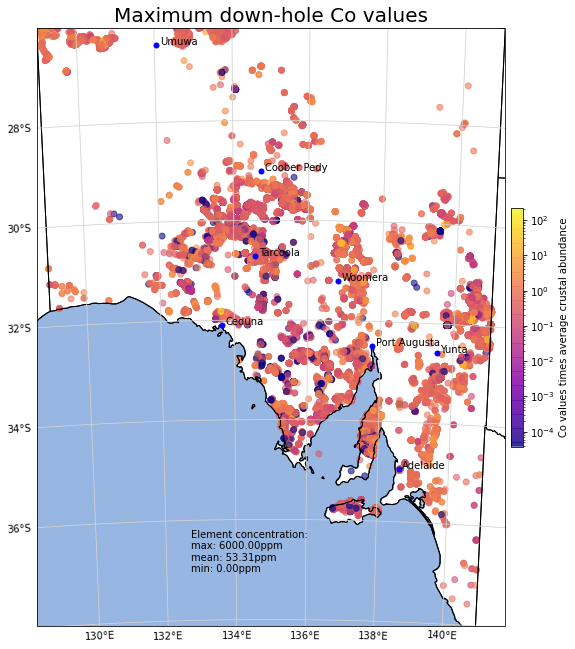

In [25]:
mpl.rcParams['agg.path.chunksize'] = 10000

title = f'Maximum down-hole {element} values'
label = f'{element} values times average crustal abundance'
out_fig = out_path+'\\'+f'Max_downhole_{element}.jpg'
inset_title = f'Number of drill holes:\n{n_dh}'
x, y = norm_data.LONGITUDE_GDA2020.values, norm_data.LATITUDE_GDA2020.values
max_val, min_val, mean_val = norm_data.converted_ppm.max(), norm_data.converted_ppm.min(), norm_data.converted_ppm.mean()
annot = f'Element concentration:\nmax: {max_val:.2f}ppm\nmean: {mean_val:.2f}ppm\nmin: {min_val:.2f}ppm'

fig, view, inset = MapBase(proj, title, inset_title, add_inset=False)
plot = view.scatter(x, y, c=norm_data.times_ave_crustal_abund, cmap=cmap, norm=log_norm, alpha=0.6, transform=ccrs.PlateCarree())
fig.colorbar(plot, ax=view, shrink=.4, pad=0.01, label=label) #boundaries=levels, 
#inset.plot(x, y,color='blue', marker='o', markersize=2, linestyle='None', transform=ccrs.Geodetic())
    
view.annotate(text=annot, xy=(0.33,0.09), xycoords='axes fraction')
plt.savefig(out_fig, dpi=300, bbox_inches='tight')
plt.show()

In [26]:
gx, gy, img = interpolate(norm_data, proj)

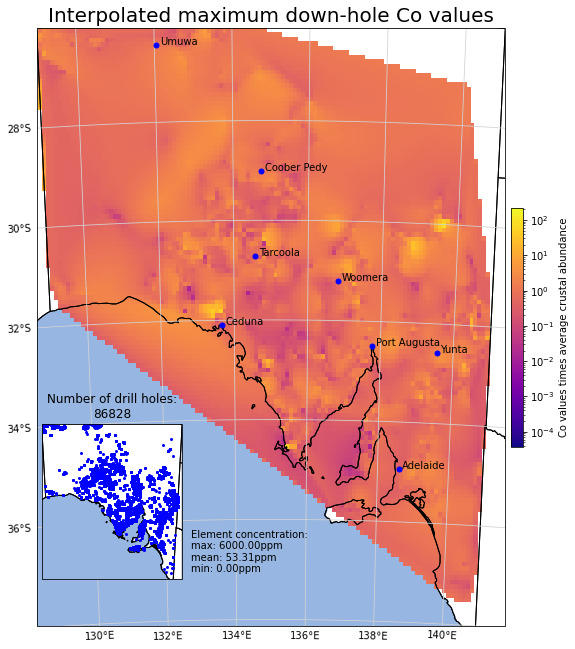

In [27]:
title = f'Interpolated maximum down-hole {element} values'
label = f'{element} values times average crustal abundance'
out_fig = out_path+'\\'+f'Interp_Max_downhole_{element}.jpg'
inset_title = f'Number of drill holes:\n{n_dh}'
x, y = norm_data.LONGITUDE_GDA2020.values, norm_data.LATITUDE_GDA2020.values
max_val, min_val, mean_val = norm_data.converted_ppm.max(), norm_data.converted_ppm.min(), norm_data.converted_ppm.mean()
annot = f'Element concentration:\nmax: {max_val:.2f}ppm\nmean: {mean_val:.2f}ppm\nmin: {min_val:.2f}ppm'

fig, view, inset = MapBase(proj, title, inset_title)
mmb = view.pcolormesh(gx, gy, img, cmap=cmap, norm=log_norm)
fig.colorbar(mmb, ax=view, shrink=.4, pad=0.01, label=label) #boundaries=levels, 
inset.plot(x, y,color='blue', marker='o', markersize=2, linestyle='None', transform=ccrs.Geodetic())
    
view.annotate(text=annot, xy=(0.33,0.09), xycoords='axes fraction')
plt.savefig(out_fig, dpi=300, bbox_inches='tight')
plt.show()